In [1]:
options(repr.matrix.max.cols=60, repr.matrix.max.rows=100)
library(tidyverse)
library(ggplot2)

plotdir <- '/home/kpettie/code/github/plotting'
source(file.path(plotdir,"plotting.R"))

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.6     ✔ purrr   0.3.4
✔ tibble  3.1.7     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()



In [2]:
fontdir <- '/cashew/shared_data/fonts'
extrafont::font_import(path=fontdir, prompt=FALSE)
extrafont::choose_font('Arial')

Scanning ttf files in /cashew/shared_data/fonts ...

Extracting .afm files from .ttf files...

/cashew/shared_data/fonts/ArialMT.ttf
 : ArialMT already registered in fonts database. Skipping.

Found FontName for 0 fonts.

Scanning afm files in /opt/modules/pkgs/R/4.1.0/lib/R/library/extrafontdb/metrics



[1] "Arial"

In [50]:
outdir <- '/home/kpettie/nf_selection/abc/from_sherlock/abc_1000G/manuscript/figs/supp'
suppdir <- '/home/kpettie/nf_selection/abc/from_sherlock/abc_1000G/manuscript/figs/noCEU/supp'

d_all_fname <- '/cashew/users/kade/nextflow/selection_1000G/abc/from_sherlock/abc_1000G/090422output/diffABC/HiChIP/aggregate/allZerosFilt.meanQN.16.AFR_EUR.diff.allComponents.txt.gz'
d_all_noceu_fname <- '/cashew/users/kade/nextflow/selection_1000G/abc/from_sherlock/abc_1000G/180922outputNoCEU/diffABC/HiChIP/aggregate/allZerosFilt.meanQN.14.AFR_EUR.diff.allComponents.txt.gz'

scores_allsamps_fname <- '/home/kpettie/nf_selection/abc/from_sherlock/abc_1000G/jupyter_anal/meanQN.16.AFR_EUR.diff.ABC.Score.scoresAllSamps.txt.gz'
scores_allsamps_noceu_fname <- '/cashew/users/kade/nextflow/selection_1000G/abc/from_sherlock/abc_1000G/180922outputNoCEU/diffABC/HiChIP/allZerosFilt.meanQN.14.AFR_EUR.diff.chip.Score.scoresAllSampsFilt.txt.gz'

In [4]:
d_all <- read_tsv(d_all_fname)
d_all

Rows: 201912 Columns: 34
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (9): seqnames, strand, class, TargetGene, name, group1, group2, score_t...
dbl (22): start, end, width, TargetGeneTSS, TargetGeneExpression, distance, ...
lgl  (3): isSelfPromoter, TargetGeneIsExpressed, selection_candidate

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


seqnames,start,end,width,strand,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,Score_AFR,Score_EUR,n_AFR,n_EUR,log2FoldChange,gsea_stat,group1,group2,n1,n2,p,score_type,RSNUM,max_abs_ihs,rank2_abs_ihs,rank2_percentile,selection_candidate,ihs_pos,FST,fst_percentile,FST_pos
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>
chr19,58873687,58874464,778,*,promoter,A1BG,58864865,1.819925,9210.5,FALSE,promoter|chr19:58873687-58874464,TRUE,0.325568900,0.302485848,8,8,-0.106095246,-0.157553331,AFR,EUR,8,8,0.6010,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr19,58873687,58874464,778,*,promoter,A1BG-AS1,58863335,NA,10740.5,FALSE,promoter|chr19:58873687-58874464,FALSE,0.325568900,0.302485848,8,8,-0.106095246,-0.157553331,AFR,EUR,8,8,0.6010,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr12,9255999,9256499,501,*,genic,A2M,9268825,0.095923,12576.0,FALSE,genic|chr12:9255999-9256499,FALSE,0.027690073,0.030762380,8,8,0.151798305,0.038046574,AFR,EUR,8,8,0.8210,ABC,rs226391,1.123,1.113,0.7392141,FALSE,9256354,0.19828700,0.9564241,9256255
chr12,9270729,9271300,572,*,intergenic,A2M,9268825,0.095923,2189.5,FALSE,intergenic|chr12:9270729-9271300,FALSE,0.143896513,0.205723475,8,8,0.515674798,0.336498815,AFR,EUR,8,8,0.4160,ABC,rs76971454,1.748,1.057,0.7144360,FALSE,9270897,0.07319840,0.8657801,9270989
chr22,43116666,43117166,501,*,promoter,A4GALT,43116916,9.755513,0.0,TRUE,promoter|chr22:43116666-43117166,TRUE,0.330120565,0.339264693,8,8,0.039418279,0.046395500,AFR,EUR,8,8,0.9080,ABC,rs28910284,2.265,2.051,0.9602735,TRUE,43116989,0.23220200,0.9662657,43116817
chr17,31860529,31861029,501,*,promoter,AA06,31860779,NA,0.0,TRUE,promoter|chr17:31860529-31861029,FALSE,0.011174499,0.030256254,8,8,1.437023150,0.235919086,AFR,EUR,8,8,0.2580,ABC,rs9892263,2.319,1.624,0.8987944,FALSE,31860994,0.45702400,0.9942746,31860994
chr12,53886720,53887220,501,*,genic,AAAS,53715412,24.203783,171558.0,FALSE,genic|chr12:53886720-53887220,TRUE,0.017288437,0.025570231,8,8,0.564657735,0.143358580,AFR,EUR,8,8,0.2780,ABC,rs57408986,2.095,1.934,0.9480888,FALSE,53886789,0.04269980,0.8003230,53886755
chr12,53602620,53603120,501,*,intergenic,AAAS,53715412,24.203783,112542.0,FALSE,intergenic|chr12:53602620-53603120,TRUE,0.012061557,0.012321547,8,8,0.030767331,0.007565551,AFR,EUR,8,8,0.9140,ABC,NA,NA,NA,NA,NA,NA,0.00116612,0.2892658,53602773
chr12,53718446,53718946,501,*,intergenic,AAAS,53715412,24.203783,3284.0,FALSE,intergenic|chr12:53718446-53718946,TRUE,0.124954712,0.130387265,8,8,0.061397663,0.058578828,AFR,EUR,8,8,0.7540,ABC,rs17751196,1.248,1.197,0.7735123,FALSE,53718446,0.00907578,0.5686550,53718738


In [5]:
d_all_noceu <- read_tsv(d_all_noceu_fname)
d_all_noceu

Rows: 209816 Columns: 34
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (9): seqnames, strand, class, TargetGene, name, group1, group2, score_t...
dbl (22): start, end, width, TargetGeneTSS, TargetGeneExpression, distance, ...
lgl  (3): isSelfPromoter, TargetGeneIsExpressed, selection_candidate

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


seqnames,start,end,width,strand,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,Score_AFR,Score_EUR,n_AFR,n_EUR,log2FoldChange,gsea_stat,group1,group2,n1,n2,p,score_type,RSNUM,max_abs_ihs,rank2_abs_ihs,rank2_percentile,selection_candidate,ihs_pos,FST,fst_percentile,FST_pos
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>
chr19,58838084,58838864,781,*,promoter,A1BG,58864865,1.819925,26391.0,FALSE,promoter|chr19:58838084-58838864,TRUE,0.109660759,0.12721517,8,6,0.214223383,0.156211079,AFR,EUR,8,6,0.4700,ABC,rs60121895,1.553,1.381,0.8370710,FALSE,58838509,0.07591060,0.8702811,58838509
chr19,58873687,58874546,860,*,promoter,A1BG,58864865,1.819925,9251.5,FALSE,promoter|chr19:58873687-58874546,TRUE,0.325822394,0.30436753,8,6,-0.098271302,-0.138140004,AFR,EUR,8,6,0.6460,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr19,58838084,58838864,781,*,promoter,A1BG-AS1,58863335,NA,24861.0,FALSE,promoter|chr19:58838084-58838864,FALSE,0.109660759,0.12721517,8,6,0.214223383,0.156211079,AFR,EUR,8,6,0.4700,ABC,rs60121895,1.553,1.381,0.8370710,FALSE,58838509,0.07591060,0.8702811,58838509
chr19,58873687,58874546,860,*,promoter,A1BG-AS1,58863335,NA,10781.5,FALSE,promoter|chr19:58873687-58874546,FALSE,0.325822394,0.30436753,8,6,-0.098271302,-0.138140004,AFR,EUR,8,6,0.6460,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr12,9255999,9256500,502,*,genic,A2M,9268825,0.095923,12575.5,FALSE,genic|chr12:9255999-9256500,FALSE,0.027001601,0.03554471,8,6,0.396589894,0.093062579,AFR,EUR,8,6,0.6110,ABC,rs226391,1.123,1.113,0.7392141,FALSE,9256354,0.19828700,0.9564241,9256255
chr12,9270663,9271300,638,*,intergenic,A2M,9268825,0.095923,2156.5,FALSE,intergenic|chr12:9270663-9271300,FALSE,0.143662575,0.12375653,8,6,-0.215179604,-0.121969177,AFR,EUR,8,6,0.6970,ABC,rs76971454,1.748,1.057,0.7144360,FALSE,9270897,0.07319840,0.8657801,9270989
chr22,43116666,43117166,501,*,promoter,A4GALT,43116916,9.755513,0.0,TRUE,promoter|chr22:43116666-43117166,TRUE,0.327771139,0.32976098,8,6,0.008731885,0.009003971,AFR,EUR,8,6,0.9830,ABC,rs28910284,2.265,2.051,0.9602735,TRUE,43116989,0.23220200,0.9662657,43116817
chr17,31860529,31861029,501,*,promoter,AA06,31860779,NA,0.0,TRUE,promoter|chr17:31860529-31861029,FALSE,0.010867865,0.03567143,8,6,1.714700391,0.257397119,AFR,EUR,8,6,0.2730,ABC,rs9892263,2.319,1.624,0.8987944,FALSE,31860994,0.45702400,0.9942746,31860994
chr12,53886720,53887220,501,*,genic,AAAS,53715412,24.203783,171558.0,FALSE,genic|chr12:53886720-53887220,TRUE,0.017134852,0.01934447,8,6,0.174987512,0.053523103,AFR,EUR,8,6,0.5190,ABC,rs57408986,2.095,1.934,0.9480888,FALSE,53886789,0.04269980,0.8003230,53886755


In [6]:
abcPlotMA2 <- function(df,
                      prefix=NULL,
                      depthcol1='Score_AFR',
                      depthcol2='Score_EUR',
                      depthtype='Score',
                      lfc_col='log2FoldChange',
                      sig_col='p',
                      sig_thresh=0.05,
                      facets="cre_type",
                      fscales="free_x",
                      frows=1,
                      fdir='h',
                      w=14,
                      h=7,
                      debug=FALSE) {

    if (!is.null(prefix)) {
        depthcol1 <- paste0(prefix,'.Score_AFR')
        depthcol2 <- paste0(prefix,'.Score_EUR')
        depthtype <- paste0(prefix,'.Score')
        lfc_col <- paste0(prefix,'.log2FoldChange')
        sig_col <- paste0(prefix,'.p')

        df <- df %>%
            dplyr::filter(across(starts_with(prefix), ~ (!is.na(.x) & is.finite(.x))))
    } else {
        df <- df %>%
            dplyr::filter(across(all_of(c(lfc_col,sig_col)), ~ (!is.na(.x) & is.finite(.x))))
    }

    dfp <- df %>%
        mutate("mean_{depthtype}" := (.data[[depthcol1]] + .data[[depthcol2]])/2,
               cre_type = if_else(class=='promoter','promoter','enhancer'),
               significant = if_else(.data[[sig_col]] < sig_thresh, TRUE, FALSE)) %>%
        arrange(desc(.data[[sig_col]]))

    p1 <- plotCorrelation(dfp,
                    paste0('mean','_',depthtype),
                    lfc_col,
                    groupvar = "significant",
                    groupvarlab=paste0(sig_col,' < ',sig_thresh),
                    colorvals = c("gray","red"),
                    addline = c(0,0),
                    legendpos = c(.98,.46),
                    corrpos = c(.25,2.5),
                    corrcolor = "black",
                    w = w, h = h,
                    logscale = TRUE,
                    xlogonly=TRUE,
                    facets = facets,
                    fscales=fscales,
                    frows = frows,
                    fdir = fdir,
                    facetorder=FALSE,
                    orderpval=FALSE,
                    debug=FALSE)

    return(p1)

}

facetAbcPlotMA2 <- function(df, w=27, h=15) {

    p1 <- abcPlotMA2(df,
                  prefix=NULL,
                  depthcol1='Score_AFR',
                  depthcol2='Score_EUR',
                  depthtype='Score',
                  lfc_col='log2FoldChange',
                  sig_col='p',
                  sig_thresh=0.05,
                  facets=c('score_type','cre_type'),
                  fscales='free',
                  frows=2,
                  fdir='v',
                  w=w,
                  h=h,
                  debug=FALSE) +
        theme(plot.margin = unit(c(0,2,0,0),"line"))

    return(p1)

}

Warning message:
“Using `across()` in `filter()` is deprecated, use `if_any()` or `if_all()`.”
Note: Using an external vector in selections is ambiguous.
ℹ Use `all_of(xvar)` instead of `xvar` to silence this message.
ℹ See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.
Note: Using an external vector in selections is ambiguous.
ℹ Use `all_of(yvar)` instead of `yvar` to silence this message.
ℹ See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.


[1] "0 potentially repeated, non-finite elements dropped"


`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.
Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'



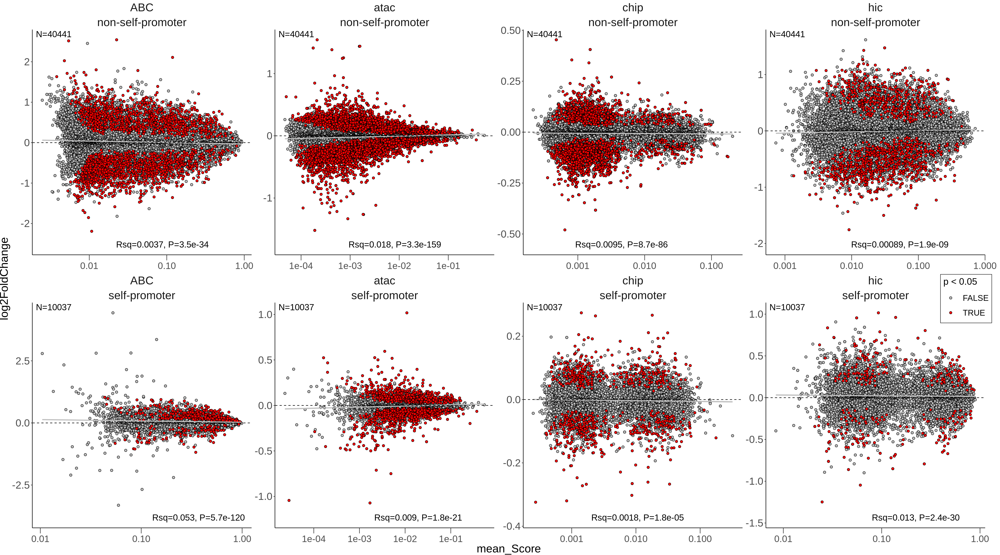

In [7]:
options(repr.plot.width = 33.75, repr.plot.height = 15, repr.plot.res = 200)
p1 <- facetAbcPlotMA(d_all) + 
    theme(legend.position = c(.98,.46))
p1
# ggsave(file.path(outdir, paste0(outbase, "FigS1d.png")), width=33.75, height=15)

Warning message:
“Using `across()` in `filter()` is deprecated, use `if_any()` or `if_all()`.”


[1] "0 potentially repeated, non-finite elements dropped"


`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.
Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'



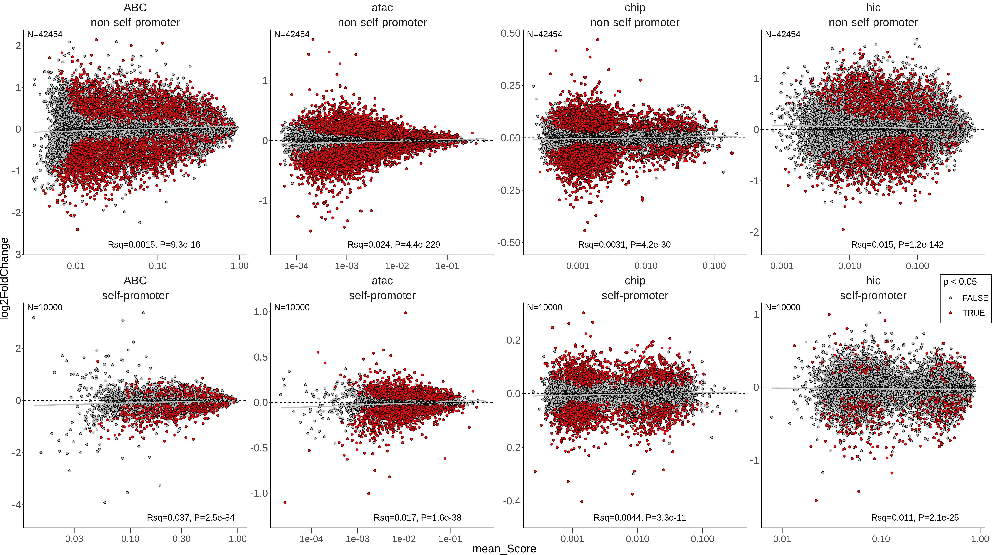

In [8]:
options(repr.plot.width = 33.75, repr.plot.height = 15, repr.plot.res = 200)
p2 <- facetAbcPlotMA(d_all_noceu) + 
    theme(legend.position = c(.98,.46))
p2

Warning message:
“Using `across()` in `filter()` is deprecated, use `if_any()` or `if_all()`.”


[1] "0 potentially repeated, non-finite elements dropped"


`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.
Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'

Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'



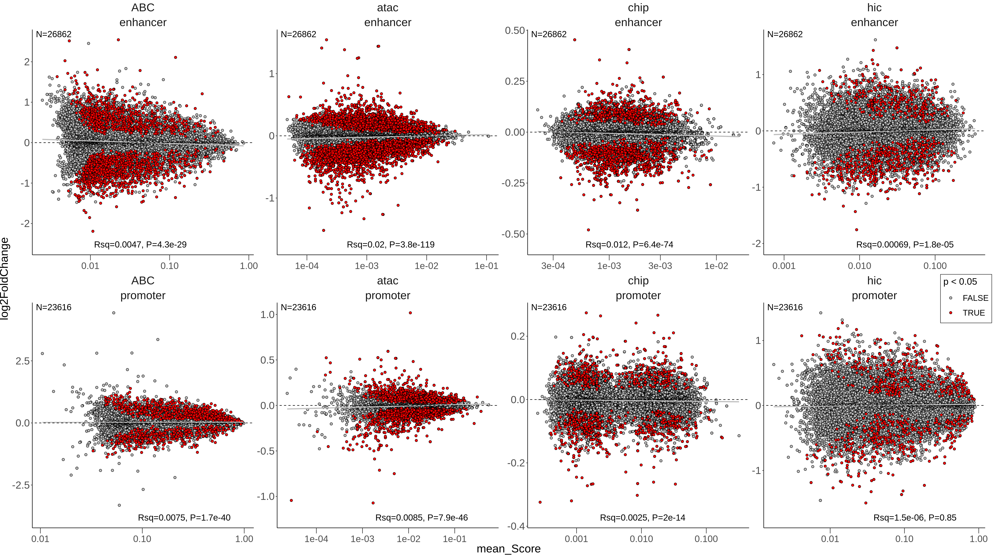

In [49]:
options(repr.plot.width = 33.75, repr.plot.height = 15, repr.plot.res = 200)
p3 <- facetAbcPlotMA2(d_all)
p3

ggsave(file.path(outdir, "FigS1_MAplots_withCEU.png"), width=33.75, height=15)

Warning message:
“Using `across()` in `filter()` is deprecated, use `if_any()` or `if_all()`.”


[1] "0 potentially repeated, non-finite elements dropped"


`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.
Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'

Warning message:
“Transformation introduced infinite values in continuous x-axis”
`geom_smooth()` using formula 'y ~ x'



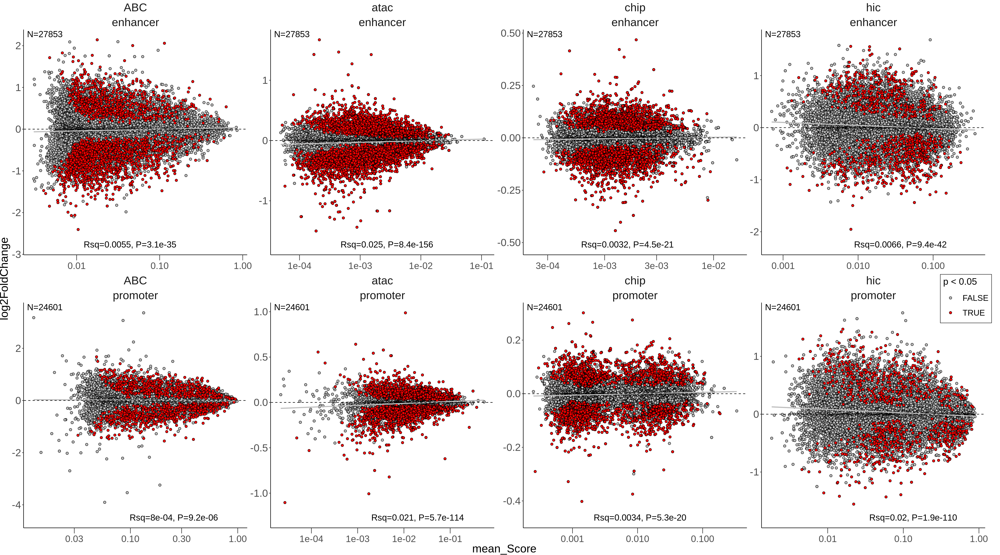

In [51]:
options(repr.plot.width = 33.75, repr.plot.height = 15, repr.plot.res = 200)
p4 <- facetAbcPlotMA2(d_all_noceu)
p4

ggsave(file.path(suppdir, "FigS1_MAplots.png"), width=33.75, height=15)

In [45]:
?rstatix::t_test

In [44]:
d_all_noceu %>% 
    filter(score_type=='chip')

seqnames,start,end,width,strand,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,Score_AFR,Score_EUR,n_AFR,n_EUR,log2FoldChange,gsea_stat,group1,group2,n1,n2,p,score_type,RSNUM,max_abs_ihs,rank2_abs_ihs,rank2_percentile,selection_candidate,ihs_pos,FST,fst_percentile,FST_pos
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>
chr19,58838084,58838864,781,*,promoter,A1BG,58864865,1.819925,26391.0,FALSE,promoter|chr19:58838084-58838864,TRUE,0.0026976115,0.0026845484,8,6,-7.003151e-03,-1.042793e-03,AFR,EUR,8,6,0.70700,chip,rs60121895,1.553,1.381,0.8370710,FALSE,58838509,0.07591060,0.8702811,58838509
chr19,58873687,58874546,860,*,promoter,A1BG,58864865,1.819925,9251.5,FALSE,promoter|chr19:58873687-58874546,TRUE,0.0025250849,0.0024486646,8,6,-4.433668e-02,-6.351850e-03,AFR,EUR,8,6,0.13800,chip,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr19,58838084,58838864,781,*,promoter,A1BG-AS1,58863335,NA,24861.0,FALSE,promoter|chr19:58838084-58838864,FALSE,0.0026956611,0.0026822624,8,6,-7.188735e-03,-1.070011e-03,AFR,EUR,8,6,0.70000,chip,rs60121895,1.553,1.381,0.8370710,FALSE,58838509,0.07591060,0.8702811,58838509
chr19,58873687,58874546,860,*,promoter,A1BG-AS1,58863335,NA,10781.5,FALSE,promoter|chr19:58873687-58874546,FALSE,0.0025232569,0.0024465778,8,6,-4.452195e-02,-6.375906e-03,AFR,EUR,8,6,0.13700,chip,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.10197300,0.9011235,58874262
chr12,9255999,9256500,502,*,genic,A2M,9268825,0.095923,12575.5,FALSE,genic|chr12:9255999-9256500,FALSE,0.0008114010,0.0007914489,8,6,-3.591888e-02,-2.920689e-03,AFR,EUR,8,6,0.36800,chip,rs226391,1.123,1.113,0.7392141,FALSE,9256354,0.19828700,0.9564241,9256255
chr12,9270663,9271300,638,*,intergenic,A2M,9268825,0.095923,2156.5,FALSE,intergenic|chr12:9270663-9271300,FALSE,0.0007412291,0.0006829737,8,6,-1.180895e-01,-9.065244e-03,AFR,EUR,8,6,0.07880,chip,rs76971454,1.748,1.057,0.7144360,FALSE,9270897,0.07319840,0.8657801,9270989
chr22,43116666,43117166,501,*,promoter,A4GALT,43116916,9.755513,0.0,TRUE,promoter|chr22:43116666-43117166,TRUE,0.0061179740,0.0055049215,8,6,-1.523320e-01,-3.342254e-02,AFR,EUR,8,6,0.00465,chip,rs28910284,2.265,2.051,0.9602735,TRUE,43116989,0.23220200,0.9662657,43116817
chr17,31860529,31861029,501,*,promoter,AA06,31860779,NA,0.0,TRUE,promoter|chr17:31860529-31861029,FALSE,0.0005450077,0.0004833290,8,6,-1.732709e-01,-1.131077e-02,AFR,EUR,8,6,0.01600,chip,rs9892263,2.319,1.624,0.8987944,FALSE,31860994,0.45702400,0.9942746,31860994
chr12,53886720,53887220,501,*,genic,AAAS,53715412,24.203783,171558.0,FALSE,genic|chr12:53886720-53887220,TRUE,0.0009437756,0.0009172751,8,6,-4.108933e-02,-3.600585e-03,AFR,EUR,8,6,0.28500,chip,rs57408986,2.095,1.934,0.9480888,FALSE,53886789,0.04269980,0.8003230,53886755


In [11]:
fdrFromPvalCutoff <- function(df, pval_col, pval) {
    
    df <- df %>% 
        rename(pvar := {{pval_col}})
    
    dfp <- df %>% 
        filter(!is.na(pvar))
    
    nsig_exp <- nrow(dfp)*pval
    nsig_obs <- dfp %>% 
        filter(pvar < pval) %>% 
        nrow()
    
    return(nsig_exp/nsig_obs)
    
}

fdrFromPvals <- function(pvs, pval) {
    pvs <- pvs[!is.na(pvs)]
    nsig_exp <- length(pvs)*pval
    nsig_obs <- length(pvs[pvs<pval])
    return(nsig_exp/nsig_obs)
}

In [12]:
d_all %>% 
    mutate(pvthresh=0.05) %>% 
    group_by(score_type,pvthresh) %>% 
    summarize(fdr = fdrFromPvals(p, 0.05))

`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.


score_type,pvthresh,fdr
<chr>,<dbl>,<dbl>
ABC,0.05,0.8670216
atac,0.05,0.2617068
chip,0.05,0.5190006
hic,0.05,1.3117983


In [13]:
d_all_noceu %>% 
    mutate(pvthresh=0.05) %>% 
    group_by(score_type,pvthresh) %>% 
    summarize(fdr = fdrFromPvals(p, 0.05))

`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.


score_type,pvthresh,fdr
<chr>,<dbl>,<dbl>
ABC,0.05,0.7201263
atac,0.05,0.2114399
chip,0.05,0.2712483
hic,0.05,1.1141461


In [14]:
head(d_all)

seqnames,start,end,width,strand,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,Score_AFR,Score_EUR,n_AFR,n_EUR,log2FoldChange,gsea_stat,group1,group2,n1,n2,p,score_type,RSNUM,max_abs_ihs,rank2_abs_ihs,rank2_percentile,selection_candidate,ihs_pos,FST,fst_percentile,FST_pos
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>
chr19,58873687,58874464,778,*,promoter,A1BG,58864865,1.819925,9210.5,FALSE,promoter|chr19:58873687-58874464,TRUE,0.32556890,0.30248585,8,8,-0.10609525,-0.15755333,AFR,EUR,8,8,0.601,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.1019730,0.9011235,58874262
chr19,58873687,58874464,778,*,promoter,A1BG-AS1,58863335,NA,10740.5,FALSE,promoter|chr19:58873687-58874464,FALSE,0.32556890,0.30248585,8,8,-0.10609525,-0.15755333,AFR,EUR,8,8,0.601,ABC,rs145521824,1.399,0.940,0.6576563,FALSE,58873694,0.1019730,0.9011235,58874262
chr12,9255999,9256499,501,*,genic,A2M,9268825,0.095923,12576.0,FALSE,genic|chr12:9255999-9256499,FALSE,0.02769007,0.03076238,8,8,0.15179830,0.03804657,AFR,EUR,8,8,0.821,ABC,rs226391,1.123,1.113,0.7392141,FALSE,9256354,0.1982870,0.9564241,9256255
chr12,9270729,9271300,572,*,intergenic,A2M,9268825,0.095923,2189.5,FALSE,intergenic|chr12:9270729-9271300,FALSE,0.14389651,0.20572347,8,8,0.51567480,0.33649881,AFR,EUR,8,8,0.416,ABC,rs76971454,1.748,1.057,0.7144360,FALSE,9270897,0.0731984,0.8657801,9270989
chr22,43116666,43117166,501,*,promoter,A4GALT,43116916,9.755513,0.0,TRUE,promoter|chr22:43116666-43117166,TRUE,0.33012057,0.33926469,8,8,0.03941828,0.04639550,AFR,EUR,8,8,0.908,ABC,rs28910284,2.265,2.051,0.9602735,TRUE,43116989,0.2322020,0.9662657,43116817
chr17,31860529,31861029,501,*,promoter,AA06,31860779,NA,0.0,TRUE,promoter|chr17:31860529-31861029,FALSE,0.01117450,0.03025625,8,8,1.43702315,0.23591909,AFR,EUR,8,8,0.258,ABC,rs9892263,2.319,1.624,0.8987944,FALSE,31860994,0.4570240,0.9942746,31860994


In [15]:
plotDirectionByPval <- function(df,
                                direction_var='log2FoldChange',
                                p_var='p',
                                pvs=c(1,.5,0.05,0.005,5e-4,5e-5,0),
                                colorvals=c("#2E3191","#F05A28"),
                                titlesize=28,
                                textsize=26,
                                ylimadj=0.1,
                                facets=NULL,
                                updownlabs=NULL, # c(label_for_up_direction, label_for_down_direction)
                                debug=FALSE
                               ) {

    dfs <- df %>%
        dplyr::rename(dvar := {{direction_var}},
                      pval := {{p_var}}) %>%
        group_by(across(any_of(facets))) %>% 
        group_by(pvalue=cut(pval, breaks=pvs, include.lowest=TRUE), .add=TRUE) %>%
        summarize(N_up=sum(dvar > 0),
                  N_down=sum(dvar < 0)) %>%
        pivot_longer(cols=dplyr::starts_with("N_"),
                     names_to="direction",
                     names_prefix="N_",
                     values_to="count")

    if (!is.null(updownlabs)) {
        dfs <- dfs %>%
            mutate(direction = case_when(direction=='up' ~ updownlabs[1],
                                         direction=='down' ~ updownlabs[2]))
    }
    
    ylim_blank <- dfs %>% 
        group_by(across(any_of(facets))) %>% 
        mutate(adjylim = max(count)*(1+ylimadj))
    
    if (debug) return(dfs)

    p1 <- ggplot(dfs, aes(x=pvalue, y=count, fill=direction)) +
        geom_bar(stat="identity", position="dodge", width=0.7) +
        geom_text(position=position_dodge(width=.7),aes(y=count+10,label=count,hjust=0)) +
        geom_blank(data=ylim_blank, aes(x=pvalue, y=adjylim, color=NULL)) + 
#         scale_y_continuous(expand = c(.1, .1)) +
        scale_fill_manual(values=c("#2E3191","#F05A28")) +
        coord_flip() + 
        labs(
            y = "Number of E-G pairs",
            x = "P-value window",
            fill = "Direction") +
        theme_classic() +
        theme(axis.text.x = element_text(size=textsize),
              axis.text.y = element_text(size=textsize),
        #           axis.ticks.length.x = unit(0.75, "line"),
              axis.title.x = element_text(size=titlesize),
              axis.title.y = element_text(size=titlesize),
              legend.position = c(.15,.3),
              legend.title = element_text(size=titlesize),
              legend.text = element_text(size=textsize),
              legend.key.size = unit(1.75, "line"),
              legend.background = element_rect(fill = "transparent",colour = NA),
        #           legend.box.background = element_rect(fill = "transparent",colour = NA),
              legend.box.background = element_rect(colour = "black"),
        #           panel.background = element_rect(fill = "transparent",colour = NA)
                  plot.margin = unit(c(0,2,0,0),"line")
        #           plot.background = element_rect(fill = "transparent",colour = NA)
             )

    return(p1)
}

`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.


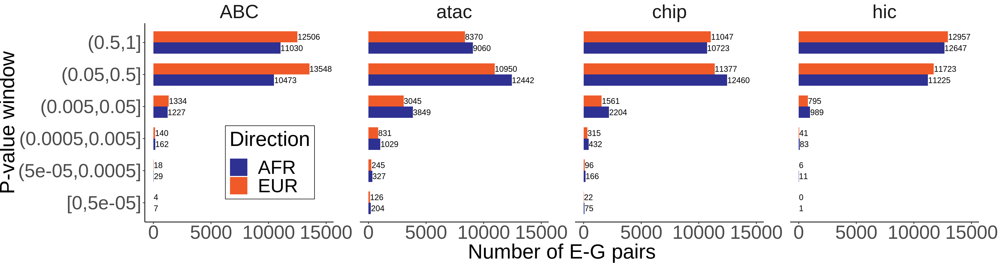

In [16]:
options(repr.plot.width = 19, repr.plot.height = 5, repr.plot.res = 200)

titlesize <- 28
textsize <- 26

plotDirectionByPval(d_all,
                          direction_var='log2FoldChange',
                          p_var='p',
                          pvs=c(1,.5,0.05,0.005,5e-4,5e-5,0),
                          colorvals=c("#2E3191","#F05A28"),
                          facets='score_type',
                          titlesize=titlesize,
                          textsize=textsize,
                            ylimadj=0.1,
                          updownlabs=c('EUR','AFR'), # c(label_for_up_direction, label_for_down_direction)
                          debug=FALSE
                         ) + 
    facet_wrap('score_type', nrow=1, dir='h', scales='fixed') + 
    theme(strip.background = element_blank(),
              strip.placement = "outside",
              strip.text = element_text(size=textsize),
          panel.spacing = unit(2.5, "line"))

`summarise()` has grouped output by 'score_type'. You can override using the
`.groups` argument.


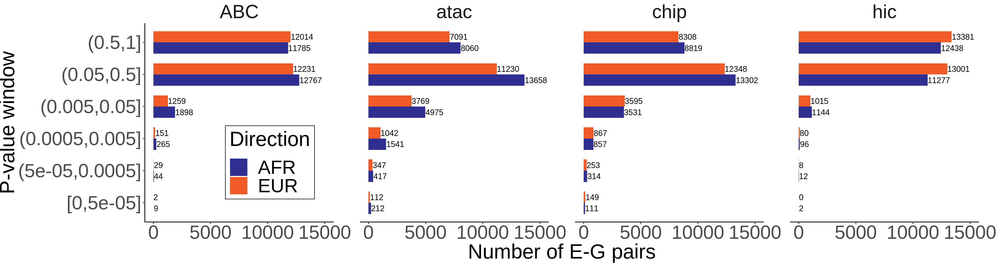

In [17]:
options(repr.plot.width = 19, repr.plot.height = 5, repr.plot.res = 200)

plotDirectionByPval(d_all_noceu,
                          direction_var='log2FoldChange',
                          p_var='p',
                          pvs=c(1,.5,0.05,0.005,5e-4,5e-5,0),
                          colorvals=c("#2E3191","#F05A28"),
                          facets='score_type',
                          titlesize=titlesize,
                          textsize=textsize,
                            ylimadj=0.1,
                          updownlabs=c('EUR','AFR'), # c(label_for_up_direction, label_for_down_direction)
                          debug=FALSE
                         ) + 
    facet_wrap('score_type', nrow=1, dir='h', scales='fixed') + 
    theme(strip.background = element_blank(),
              strip.placement = "outside",
              strip.text = element_text(size=textsize),
          panel.spacing = unit(2.5, "line"))

In [18]:
scores_allsamps_noceu <- read_tsv(scores_allsamps_noceu_fname)
scores_allsamps_noceu

Rows: 734356 Columns: 59
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr (10): chr, class, TargetGene, name, CellType, sample, population, rep, q...
dbl (47): start, end, TargetGeneTSS, TargetGeneExpression, distance, powerla...
lgl  (2): isSelfPromoter, TargetGeneIsExpressed

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,powerlaw_contact,powerlaw_contact_reference,hic_contact,activity_base,atac.Score.Numerator,nEnh.atac,activity_base_sum,atac.Score,powerlaw.Score.Numerator,nEnh.ABC,powerlaw.Score,hic_enh_total,hic_tss_total,chip_estimate,nEnh.chip,chip_estimate_sum,chip_estimate_sum1,chip_estimate_adj,chip.Score,normalized_hic_contact,hic_contact_pl_scaled,hic_contact_sum,hic_contact_sum1,hic_contact_pl_scaled_adj,hic_estimate,hic_enh_total_sum,hic_tss_total_sum,hic_estimate_sum,hic_estimate_sum1,hic_estimate_adj,hic_estimate_adj_old,hic.Score.Numerator,nEnh.hic,hic.Score,activity_estimate,nEnh.activity,activity_estimate_sum,activity_estimate_sum1,activity_estimate_adj,activity.Score,ABC.Score.Numerator,ABC.Score,CellType,sample,population,rep,qnorm,ancestry
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
chr1,10003167,10003735,promoter,LZIC,10003485,7.781197,34.0,TRUE,promoter|chr1:10003167-10003735,TRUE,0.123436,0.123436,9,15.3443021,15.3443021,1845,2370.7663,0.006472296,1.894039270,902,0.293603803,710.7143,710.7143,710.7143,1849,708389.81,0.0010032814,0.3746746,0.0010032814,23.214286,23.214286,414.78571,0.055966936,0.62500000,0.032663317,360751.61,641064.29,0.9070571,0.036010209,0.41669825,1.66811403,0.41669825,902,0.036010209,104.42899,902,21071.884,0.004955845,0.44160258,0.004955845,9.5901888,0.212850034,ESN_rep1.meanQN,ESN_rep1,ESN,rep1,meanQN,AFR
chr1,10003167,10003735,promoter,NMNAT1,10003485,4.698655,34.0,TRUE,promoter|chr1:10003167-10003735,TRUE,0.123436,0.123436,9,15.3443021,15.3443021,1845,2370.7663,0.006472296,1.894039270,902,0.293603803,710.7143,710.7143,710.7143,1849,708389.81,0.0010032814,0.3746746,0.0010032814,23.214286,23.214286,414.78571,0.055966936,0.62500000,0.032663317,360751.61,641064.29,0.9070571,0.036010209,0.41669825,1.66811403,0.41669825,902,0.036010209,104.42899,902,21071.884,0.004955845,0.44160258,0.004955845,9.5901888,0.212850034,ESN_rep1.meanQN,ESN_rep1,ESN,rep1,meanQN,AFR
chr1,10003167,10003735,promoter,UBE4B,10093040,11.397529,89589.0,FALSE,promoter|chr1:10003167-10003735,TRUE,0.010027,0.010027,7,15.3443021,15.3443021,1852,2373.8622,0.006463855,0.153857317,930,0.021007828,710.7143,746.7143,728.4919,1856,727678.38,0.0010011180,0.3746746,0.0010011180,17.785714,17.785714,353.35714,0.050333535,0.49015748,0.024414428,354520.36,694444.29,0.6935142,0.035203934,0.40617937,1.30822171,0.40617937,930,0.035203934,105.72701,930,21303.774,0.004962830,0.44160258,0.004962830,7.5211244,0.132495078,ESN_rep1.meanQN,ESN_rep1,ESN,rep1,meanQN,AFR
chr1,10010314,10010817,genic,LZIC,10003485,7.781197,7080.5,FALSE,genic|chr1:10010314-10010817,TRUE,0.091204,0.091204,15,4.0053876,4.0053876,1845,2370.7663,0.001689491,0.365307368,902,0.056627988,465.7857,710.7143,575.3612,1849,708389.81,0.0008122099,0.3033192,0.0008122099,37.142857,37.142857,414.78571,0.089547098,1.00000000,0.064555716,360751.61,641064.29,0.9070571,0.071170508,0.82356163,3.29685737,0.82356163,902,0.071170508,48.00567,902,21071.884,0.002278186,0.20300329,0.002278186,4.0053876,0.088897821,ESN_rep1.meanQN,ESN_rep1,ESN,rep1,meanQN,AFR
chr1,10010314,10010817,genic,NMNAT1,10003485,4.698655,7080.5,FALSE,genic|chr1:10010314-10010817,TRUE,0.091204,0.091204,15,4.0053876,4.0053876,1845,2370.7663,0.001689491,0.365307368,902,0.056627988,465.7857,710.7143,575.3612,1849,708389.81,0.0008122099,0.3033192,0.0008122099,37.142857,37.142857,414.78571,0.089547098,1.00000000,0.064555716,360751.61,641064.29,0.9070571,0.071170508,0.82356163,3.29685737,0.82356163,902,0.071170508,48.00567,902,21071.884,0.002278186,0.20300329,0.002278186,4.0053876,0.088897821,ESN_rep1.meanQN,ESN_rep1,ES

In [19]:
shuffle_cdt <- function(scores, 
                              cdt_col='ancestry',
                              subj_col='population', 
                              model_reps=TRUE,
                              groupvars=c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                            'TargetGeneExpression','distance','isSelfPromoter','name',
                                            'TargetGeneIsExpressed','score_type'),
                              debug=FALSE) {
    
    scores <- scores %>% 
        dplyr::rename(cdt := {{cdt_col}},
                      subject := {{subj_col}})
    
    if (debug) {
        scores <- scores %>% 
            dplyr::select(TargetGene,name,ABC.Score,sample,subject,rep,cdt) %>% 
            arrange(TargetGene,name) %>% 
            head(32)
    }
    
    if (model_reps) {
        permlabs <- scores %>% 
            dplyr::select(any_of(groupvars),subject,cdt) %>% 
            group_by(across(any_of(groupvars)),subject) %>% 
            dplyr::slice(1) %>% 
            ungroup() %>% 
            group_by(across(any_of(groupvars))) %>% 
            mutate(perm_cdt = sample(cdt)) %>% 
            ungroup()
        
        scores <- merge(scores, permlabs)
        
    } else {
        scores <- scores %>% 
            group_by(across(any_of(groupvars))) %>% 
            mutate(perm_cdt = sample(cdt)) %>% 
            ungroup()
    }
    
    scores <- scores %>% 
        dplyr::rename(!!cdt_col := cdt,
                      !!subj_col := subject)
    
    return(scores)
    
}

narrow_scores <- function(df,
                          groupvars=c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                      'TargetGeneExpression','distance','isSelfPromoter','name',
                                      'TargetGeneIsExpressed','ABC.Score','atac.Score','chip.Score',
                                      'hic.Score','sample','population','rep','ancestry'),
                          cdt_col='ancestry',
                          subj_col='population',
                          debug=FALSE,
                          Ntestpairs=100,
                          Ntestsamps=16) {
    
    if (debug) {
        df <- df %>% 
            select(any_of(groupvars)) %>% 
            arrange(TargetGene,name) %>% 
            head(Ntestpairs*Ntestsamps)
    }
    
    dfn <- df %>% 
        rename(cdt := {{cdt_col}},
               subject := {{subj_col}}) %>% 
        select(any_of(groupvars),subject,cdt) %>% 
        pivot_longer(cols=ends_with('Score'),
                     names_to=c("score_type", ".value"),
                     names_pattern="(.*)\\.(.*)") %>% 
        rename(!!cdt_col := cdt,
               !!subj_col := subject)
        
    
}

tnarr <- narrow_scores(scores_allsamps_noceu, debug=TRUE, Ntestsamps=14)
tnarr

chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,sample,rep,population,ancestry,score_type,Score
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep1,rep1,ESN,AFR,ABC,0.189529355
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep1,rep1,ESN,AFR,atac,0.008950936
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep1,rep1,ESN,AFR,chip,0.002645816
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep1,rep1,ESN,AFR,hic,0.100893542
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep2,rep2,ESN,AFR,ABC,0.068842910
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep2,rep2,ESN,AFR,atac,0.009038393
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep2,rep2,ESN,AFR,chip,0.002654017
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN_rep2,rep2,ESN,AFR,hic,0.018424597
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,FIN_rep1,rep1,FIN,EUR,ABC,0.153482185


In [20]:
tnarr <- shuffle_cdt(tnarr, 
                  cdt_col='ancestry',
                  subj_col='population', 
                  model_reps=TRUE,
                  groupvars=c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                'TargetGeneExpression','distance','isSelfPromoter','name',
                                'TargetGeneIsExpressed','score_type'),
                  debug=FALSE) %>% 
    arrange(TargetGene, name, score_type, ancestry, sample)
tnarr

chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,population,ancestry,score_type,sample,rep,Score,perm_cdt
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN,AFR,ABC,ESN_rep1,rep1,0.189529355,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN,AFR,ABC,ESN_rep2,rep2,0.068842910,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,GWD,AFR,ABC,GWD_rep1,rep1,0.081381672,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,GWD,AFR,ABC,GWD_rep2,rep2,0.104693946,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,LWK,AFR,ABC,LWK_rep1,rep1,0.074041900,AFR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,LWK,AFR,ABC,LWK_rep2,rep2,0.105012943,AFR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,YRI,AFR,ABC,YRI_rep1,rep1,0.074536421,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,YRI,AFR,ABC,YRI_rep2,rep2,0.179246925,EUR
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,FIN,EUR,ABC,FIN_rep1,rep1,0.153482185,AFR


In [21]:
groupvars <- c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                'TargetGeneExpression','distance','isSelfPromoter','name',
                                'TargetGeneIsExpressed','score_type')
cdt_col <- 'ancestry'

tnarr_test <- tnarr %>%
    rename(condition := {{cdt_col}}) %>% 
    group_by(across(all_of(groupvars))) %>%
    rstatix::t_test(Score ~ condition, p.adjust.method='bonferroni')
tnarr_test

,chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,score_type,.y.,group1,group2,n1,n2,statistic,df,p
,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,ABC,Score,AFR,EUR,8,6,1.13370106,10.690054,0.28200
2,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,atac,Score,AFR,EUR,8,6,-0.81142869,7.450868,0.44200
3,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,chip,Score,AFR,EUR,8,6,3.34721885,11.298962,0.00628
4,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,hic,Score,AFR,EUR,8,6,0.66919724,10.816733,0.51700
5,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,ABC,Score,AFR,EUR,8,6,0.59074303,11.742808,0.56600
6,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,atac,Score,AFR,EUR,8,6,1.03907832,11.986499,0.31900
7,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,chip,Score,AFR,EUR,8,6,1.20566444,11.956556,0.25100
8,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,hic,Score,AFR,EUR,8,6,0.75421594,11.975144,0.46500
9,chr11,77531630,77532409,promoter,AAMDC,77532159,4.445793,139.5,TRUE,promoter|chr11:77531630-77532409,TRUE,ABC,Score,AFR,EUR,8,6,1.41582699,7.127992,0.19900


In [23]:
tnarr_null <- tnarr %>%
    rename(condition := {{cdt_col}}) %>% 
    group_by(across(all_of(groupvars))) %>%
    rstatix::t_test(Score ~ perm_cdt, p.adjust.method='bonferroni')
tnarr_null

,chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,score_type,.y.,group1,group2,n1,n2,statistic,df,p
,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,ABC,Score,AFR,EUR,8,6,1.75045124,11.923893,0.1060
2,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,atac,Score,AFR,EUR,8,6,0.34323598,8.734835,0.7400
3,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,chip,Score,AFR,EUR,8,6,1.27660328,11.297503,0.2270
4,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,hic,Score,AFR,EUR,8,6,-0.24600985,11.492197,0.8100
5,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,ABC,Score,AFR,EUR,8,6,1.06148996,9.376412,0.3150
6,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,atac,Score,AFR,EUR,8,6,-0.59209575,9.660911,0.5670
7,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,chip,Score,AFR,EUR,8,6,-0.60152575,7.915068,0.5640
8,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,hic,Score,AFR,EUR,8,6,1.41934833,9.398796,0.1880
9,chr11,77531630,77532409,promoter,AAMDC,77532159,4.445793,139.5,TRUE,promoter|chr11:77531630-77532409,TRUE,ABC,Score,AFR,EUR,8,6,-0.35364841,10.577381,0.7310


In [24]:
estimateFDR <- function(tdf, ndf, group_col='score_type', pcol='p', pthresh=0.05) {
    
    tsum <- as_tibble(tdf) %>% 
        select(all_of(c(group_col, pcol))) %>% 
        group_by(across(all_of(group_col))) %>% 
        summarize(Nsig_obs = sum(.data[[pcol]] < pthresh, na.rm=TRUE))
    
    nsum <- as_tibble(ndf) %>% 
        select(all_of(c(group_col, pcol))) %>% 
        group_by(across(all_of(group_col))) %>% 
        summarize(Nsig_exp = sum(.data[[pcol]] < pthresh, na.rm=TRUE))
    
    fdrdf <- merge(tsum, nsum) %>% 
        mutate(pvthresh = pthresh,
               perm_fdr = Nsig_exp/Nsig_obs)
    
    return(fdrdf)
}

fdrest <- estimateFDR(tnarr_test, tnarr_null)
fdrest

score_type,Nsig_obs,Nsig_exp,pvthresh,perm_fdr
<chr>,<int>,<int>,<dbl>,<dbl>
ABC,4,6,0.05,1.5000000
atac,23,13,0.05,0.5652174
chip,14,16,0.05,1.1428571
hic,3,7,0.05,2.3333333


In [37]:
shuffle_cdt_reps_proxy <- function(scores, 
                                  cdt_col='ancestry',
                                  subj_col='population', 
                                  model_reps=TRUE,
                                  groupvars=c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                                'TargetGeneExpression','distance','isSelfPromoter','name',
                                                'TargetGeneIsExpressed','score_type'),
                                  debug=FALSE,
                                  checkout=FALSE) {
    
    scores <- scores %>% 
        dplyr::rename(cdt := {{cdt_col}},
                      subject := {{subj_col}})
    
    if (debug) {
        scores <- scores %>% 
            dplyr::select(TargetGene,name,Score,sample,subject,rep,cdt) %>% 
            arrange(TargetGene,name) %>% 
            head(32)
    }
    
    # check if equal number of samples between conditions
    # to know if reps can be tested directly
    # if not, assign one subject from condition with more 
    # samples randomly to one replicate as proxy
    cdtsamps <- scores %>% 
        select(subject, sample, cdt) %>% 
        distinct() %>% 
        group_by(cdt) %>% 
        mutate(Nsubjects = n_distinct(subject),
                  Nsamples = n_distinct(sample)) %>% 
        ungroup()
    
    if (debug) return(cdtsamps)
    
    cdts <- cdtsamps %>% pull(cdt) %>% unique()
    Nsamps_cdt1 <- cdtsamps %>% filter(cdt==cdts[1]) %>% nrow()
    Nsamps_cdt2 <- cdtsamps %>% filter(cdt==cdts[2]) %>% nrow()
    
    # check if equal number of samples between conditions
    if (Nsamps_cdt1==Nsamps_cdt2) {
        scores <- scores %>% 
            group_by(across(any_of(groupvars)), subject) %>% 
            mutate(perm_reps = sample(rep)) %>% 
            ungroup()
    # if not, assign one subject from condition with more 
    # samples randomly to one replicate as proxy
    } else if (abs(Nsamps_cdt1-Nsamps_cdt2)==2) {
        if (Nsamps_cdt1>Nsamps_cdt2) {
            holdoutcdt <- cdts[1]
        } else {
            holdoutcdt <- cdts[2]
        }
        scores <- scores %>% 
            group_by(across(any_of(groupvars))) %>% 
            mutate(holdoutsub = sample(unique(subject[cdt==holdoutcdt]), 1)) %>% 
            group_by(subject, .add=TRUE) %>% 
            mutate(perm_reps = if_else(subject==holdoutsub, rep(sample(rep, 1), n()), sample(rep))) %>% 
            ungroup()
    } else {
        stop('Check number of samples per condition and handle accordingly!')
    }
    
    if (checkout) {
        scores <- scores %>% 
            dplyr::select(TargetGene,name,Score,sample,subject,rep,cdt,holdoutsub,perm_reps) %>% 
            arrange(TargetGene,name)
        return(scores)
    }
    
    scores <- scores %>% 
        dplyr::rename(!!cdt_col := cdt,
                      !!subj_col := subject)
    
    return(scores)
    
}

trep <- shuffle_cdt_reps_proxy(tnarr, 
                                  cdt_col='ancestry',
                                  subj_col='population', 
                                  groupvars=c('chr','start','end','class','TargetGene','TargetGeneTSS',
                                                'TargetGeneExpression','distance','isSelfPromoter','name',
                                                'TargetGeneIsExpressed','score_type'),
                                  debug=FALSE,
                               checkout=FALSE)
trep

chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,population,ancestry,score_type,sample,rep,Score,perm_cdt,holdoutsub,perm_reps
<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN,AFR,ABC,ESN_rep1,rep1,0.189529355,EUR,LWK,rep1
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,ESN,AFR,ABC,ESN_rep2,rep2,0.068842910,EUR,LWK,rep2
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,GWD,AFR,ABC,GWD_rep1,rep1,0.081381672,EUR,LWK,rep1
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,GWD,AFR,ABC,GWD_rep2,rep2,0.104693946,EUR,LWK,rep2
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,LWK,AFR,ABC,LWK_rep1,rep1,0.074041900,AFR,LWK,rep2
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,LWK,AFR,ABC,LWK_rep2,rep2,0.105012943,AFR,LWK,rep2
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,YRI,AFR,ABC,YRI_rep1,rep1,0.074536421,EUR,LWK,rep2
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,YRI,AFR,ABC,YRI_rep2,rep2,0.179246925,EUR,LWK,rep1
chr19,58838084,58838864,promoter,A1BG,58864865,1.819925,26391,FALSE,promoter|chr19:58838084-58838864,TRUE,FIN,EUR,ABC,FIN_rep1,rep1,0.153482185,AFR,LWK,rep2


In [39]:
trep_test <- trep %>%
    rename(condition := {{cdt_col}}) %>% 
    group_by(across(all_of(groupvars))) %>%
    rstatix::t_test(Score ~ condition, p.adjust.method='bonferroni')
trep_test

,chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,score_type,.y.,group1,group2,n1,n2,statistic,df,p
,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,ABC,Score,AFR,EUR,8,6,1.13370106,10.690054,0.28200
2,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,atac,Score,AFR,EUR,8,6,-0.81142869,7.450868,0.44200
3,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,chip,Score,AFR,EUR,8,6,3.34721885,11.298962,0.00628
4,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,hic,Score,AFR,EUR,8,6,0.66919724,10.816733,0.51700
5,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,ABC,Score,AFR,EUR,8,6,0.59074303,11.742808,0.56600
6,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,atac,Score,AFR,EUR,8,6,1.03907832,11.986499,0.31900
7,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,chip,Score,AFR,EUR,8,6,1.20566444,11.956556,0.25100
8,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,hic,Score,AFR,EUR,8,6,0.75421594,11.975144,0.46500
9,chr11,77531630,77532409,promoter,AAMDC,77532159,4.445793,139.5,TRUE,promoter|chr11:77531630-77532409,TRUE,ABC,Score,AFR,EUR,8,6,1.41582699,7.127992,0.19900


In [40]:
trep_null <- trep %>%
    rename(condition := {{cdt_col}}) %>% 
    group_by(across(all_of(groupvars))) %>%
    rstatix::t_test(Score ~ perm_reps, p.adjust.method='bonferroni')
trep_null

,chr,start,end,class,TargetGene,TargetGeneTSS,TargetGeneExpression,distance,isSelfPromoter,name,TargetGeneIsExpressed,score_type,.y.,group1,group2,n1,n2,statistic,df,p
,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<lgl>,<chr>,<lgl>,<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,ABC,Score,rep1,rep2,6,8,-0.616849454,11.999180,0.54900
2,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,atac,Score,rep1,rep2,6,8,0.252174849,11.862897,0.80500
3,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,chip,Score,rep1,rep2,6,8,-0.575025234,11.326964,0.57700
4,chr1,229643838,229644434,promoter,ABCB10,229694442,7.540873,50306.0,FALSE,promoter|chr1:229643838-229644434,TRUE,hic,Score,rep1,rep2,6,8,1.123908663,6.783421,0.29900
5,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,ABC,Score,rep1,rep2,6,8,-2.784551160,9.526809,0.02020
6,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,atac,Score,rep1,rep2,6,8,-0.554300776,7.485419,0.59600
7,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,chip,Score,rep1,rep2,6,8,-0.015894985,11.882233,0.98800
8,chr1,229761544,229762212,promoter,ABCB10,229694442,7.540873,67436.0,FALSE,promoter|chr1:229761544-229762212,TRUE,hic,Score,rep1,rep2,8,6,0.261355304,11.213193,0.79900
9,chr11,77531630,77532409,promoter,AAMDC,77532159,4.445793,139.5,TRUE,promoter|chr11:77531630-77532409,TRUE,ABC,Score,rep1,rep2,6,8,1.467354610,11.350953,0.16900


In [41]:
fdrest <- estimateFDR(trep_test, trep_null)
fdrest

score_type,Nsig_obs,Nsig_exp,pvthresh,perm_fdr
<chr>,<int>,<int>,<dbl>,<dbl>
ABC,4,4,0.05,1.00000000
atac,23,1,0.05,0.04347826
chip,14,1,0.05,0.07142857
hic,3,5,0.05,1.66666667
